<img style="float:left" width="70%" src="pics/escudo_COLOR_1L_DCHA.png">
<img style="float:right" width="15%" src="pics/PythonLogo.svg">
<br style="clear:both;">

<h2 style="display: inline-block; padding: 4mm; padding-left: 2em; background-color: navy; line-height: 1.3em; color: white; border-radius: 10px;">Segmentación de imágenes RGB por agrupamiento</h2>

<h2 style="display: inline-block; padding: 4mm; padding-left: 2em; background-color: red; line-height: 1.3em; color: white; border-radius: 10px;">Implementación de FCM, y una versión con incorporación de información espacial</h2>

### *Fuzzy C-Means* (FCM) y *Spatial Fuzzy C-Means* (sFCM)
#### Author: Pedro Latorre Carmona
#### Curso: 2025-2026
#### Alumno: Pablo Fernández Gumiel

Versión 1.0

---

# Práctica de Segmentación de Imágenes: FCM y sFCM

En este notebook, se implementan dos algoritmos de *clustering* difuso para segmentar una imagen en color RGB:

1.  **Fuzzy C-Means (FCM)**: El algoritmo estándar de agrupamiento difuso.
2.  **Spatial Fuzzy C-Means (sFCM)**: Una modificación de FCM que incorpora información espacial (de los píxeles vecinos) para ser más robusto frente al ruido.

### 1. Importación de Librerías y Carga de Imagen

Primero, importamos las librerías necesarias:
* `numpy` para cálculo numérico.
* `cv2` (OpenCV) para leer y manipular la imagen.
* `matplotlib.pyplot` para visualizar las imágenes.

##### NOTA IMPORTANTE: Aquí se implementan todos los parámetros definitivos de la práctica, es decir, van a ser los parámetros que se han utilizado para las imágenes mostradas en la comparación final. Estos parámetros importantes son: **C**, **M**, **MAX_ITER**, **EPSILON**, **RUIDO_MEAN**, **RUIDO_SIGMA**, **P** y **Q**



Imagen cargada con dimensiones: (701, 706, 3)


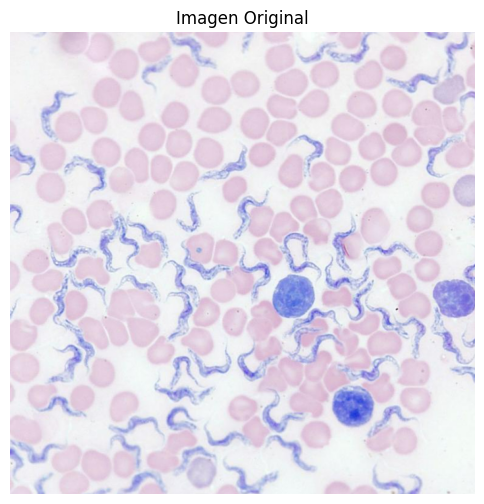

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# --- Configuración de parámetros ---
IMG_PATH = 'ImagenMicroscopiaColor.png'

# Parámetros para el clustering
# C: Número de clusters
C = 4
# M: Parámetro de "fuzziness" controla la borrosidad del clustering.
M = 2.0
# MAX_ITER: Máximo de iteraciones para el bucle del algoritmo.
MAX_ITER = 10
# EPSILON: Criterio de parada. Si el cambio en U es menor, se detiene.
EPSILON = 1e-5

# Parámetros para el ruido
Ruido_MEAN = 0.0
Ruido_SIGMA = 15.0   # Desviación estándar del ruido Gausiano.

# Parámetros para sFCM 
# P: Controla la influencia de la pertenencia original (FCM).
P = 1.0
# Q: Controla la influencia de la información espacial (vecinos).
Q = 1.0

# --- Cargar la imagen ---
# Leemos la imagen. OpenCV la carga en formato BGR.
img_bgr = cv2.imread(IMG_PATH)

# Se convierte a RGB para mostrarla correctamente con matplotlib.
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# Se normaliza la imagen a [0, 1] para los cálculos.
# Es crucial convertir a float32 ANTES de dividir para mantener la precisión.
img_norm = img_rgb.astype(np.float32) / 255.0

print(f"Imagen cargada con dimensiones: {img_norm.shape}")

# Mostrar la imagen original
plt.figure(figsize=(6, 6))
plt.title("Imagen Original")
plt.imshow(img_norm)
plt.axis('off')
plt.show()

### 2. Incorporación de Ruido Gausiano

El ruido Gaussiano añade a cada píxel un valor aleatorio extraído de una distribución normal.

* Esta distribución se define por su media ($\mu$) y su desviación estándar ($\sigma$).

* Usaremos una **media de 0**, lo que significa que el ruido no tenderá a aclarar u oscurecer la imagen en promedio.

* La **desviación estándar (`sigma`)** controlará la *intensidad* del ruido. Un `sigma` mayor generará más ruido.

* Finalmente, usamos `np.clip()` para "recortar" los valores resultantes al rango `[0, 1]`, ya que el ruido podría haber empujado algunos valores por debajo de 0 o por encima de 1.

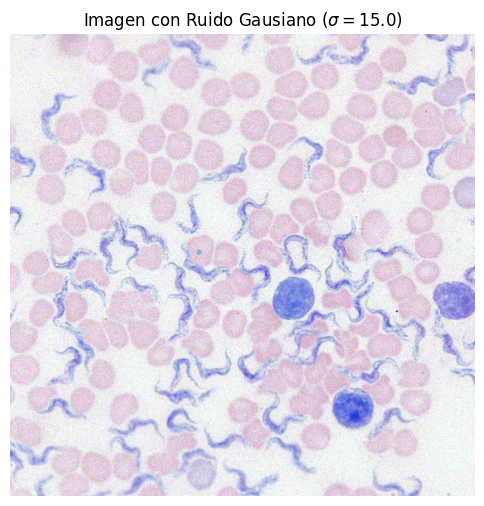

In [2]:
def aplica_ruido_gausiano(imagen, mean=0.0, sigma=1.0):
    """
    Añade ruido Gausiano a cada canal de una imagen.
    
    Args:
        imagen (np.array): Imagen de entrada (H, W, C) normalizada a [0, 1].
        mean (float): Media del ruido.
        sigma (float): Desviación estándar del ruido (en escala 0-255).
    
    Returns:
        np.array: Imagen con ruido, en rango [0, 1].
    """
    # Escalamos sigma al rango [0, 1]
    sigma_norm = sigma / 255.0
    
    # Generamos el ruido Gausiano con las mismas dimensiones que la imagen
    ruido = np.random.normal(mean, sigma_norm, imagen.shape)
    
    # Sumamos el ruido a la imagen
    imagen_ruidosa = imagen + ruido
    
    # Nos aseguramos de que los valores sigan en el rango [0, 1]
    imagen_ruidosa_clip = np.clip(imagen_ruidosa, 0.0, 1.0)
    
    return imagen_ruidosa_clip.astype(np.float32)

# Aplicamos el ruido a nuestra imagen
img_ruido = aplica_ruido_gausiano(img_norm, Ruido_MEAN, Ruido_SIGMA)

# Mostrar la imagen con ruido
plt.figure(figsize=(6, 6))
plt.title(f"Imagen con Ruido Gausiano ($\sigma={Ruido_SIGMA}$)")
plt.imshow(img_ruido)
plt.axis('off')
plt.show()

### 3. Preparación de los Datos para Clustering

Los algoritmos de clustering no trabajan con imágenes en 2D (o 3D si contamos el color). Esperan una lista de "vectores de características".

Por eso necesitamos definir esta función que "aplana" la imagen.

**Fundamento:**

* Nuestra imagen tiene forma `(Alto, Ancho, 3)`.

* Queremos convertirla a `(N_Píxeles, 3)`, donde `N_Píxeles = Alto * Ancho`.

* Cada fila de esta nueva matriz representa un único píxel, y sus 3 columnas son sus valores R, G, B.

* Usamos `img.reshape(-1, 3)` de NumPy para hacer esto eficientemente. El `-1` le dice a NumPy: "calcula tú mismo cuántas filas deben ser".

In [3]:
def preparacion_datos(imagen):
    """
    Convierte una imagen (H, W, C) en una matriz 2D (N_pixels, C).
    
    Args:
        imagen (np.array): Imagen de entrada (H, W, C).
        
    Returns:
        np.array: Datos aplanados (H*W, C).
        tuple: Dimensiones originales (H, W).
    """
    shape_original = imagen.shape
    H, W, C = shape_original
    
    # Reshape: (H, W, C) -> (H * W, C)
    # Cada fila es un píxel, cada columna es una característica (R, G, o B)
    data = imagen.reshape((H * W, C))
    
    return data, (H, W)

# Preparamos los datos de la imagen ruidosa
data_ruido, shape_original = preparacion_datos(img_ruido)
H, W = shape_original
N_PIXELS = data_ruido.shape[0]

print(f"Datos preparados para clustering:")
print(f"  - Píxeles totales (N): {N_PIXELS}")
print(f"  - Características por píxel (Dimensiones): {data_ruido.shape[1]}")

Datos preparados para clustering:
  - Píxeles totales (N): 494906
  - Características por píxel (Dimensiones): 3


### 4. Implementación de Fuzzy C-Means (FCM)

Esta es la implementación del algoritmo estándar **Fuzzy C-Means**.

**Fundamento**

El objetivo es agrupar $N$ píxeles (vectores $X_k$) en $C$ clusters, pero de forma "difusa". A diferencia de K-Means (donde un píxel pertenece a *un solo* cluster), aquí un píxel pertenece a *todos* los clusters con un cierto grado de pertenencia.

El algoritmo es iterativo y actualiza dos matrices:

1.  **Centroides ($V_i$)**: El centro de color de cada cluster $i$.

2.  **Pertenencia ($U_{ik}$)**: El grado en que el píxel $k$ pertenece al cluster $i$.

**Pasos del Algoritmo:**

1.  **Inicialización**: Se crea una matriz $U$ de `(C, N)` con valores aleatorios (cuya suma por columna es 1) y se inicializa $V$ (centroides).

2.  **Bucle Iterativo** (hasta convergencia):

    a. **Actualizar Centroides ($V_i$)**: Se calcula el nuevo centro de cada cluster como la media ponderada de todos los píxeles. La ponderación es el grado de pertenencia ($U_{ik}$) elevado al exponente de "difusión" $m$.
       $$V_i = \frac{\sum_{k=1}^{N} (U_{ik})^m \cdot X_k}{\sum_{k=1}^{N} (U_{ik})^m}$$

    b. **Actualizar Pertenencia ($U_{ik}$)**: Se recalcula el grado de pertenencia de cada píxel a cada cluster. La pertenencia es inversamente proporcional a la distancia ($d$) entre el píxel y el centroide.
       $$U_{ik} = \frac{1}{\sum_{j=1}^{C} \left(\frac{d(X_k, V_i)}{d(X_k, V_j)}\right)^{\frac{2}{m-1}}}$$

3.  **Convergencia**: El bucle se detiene cuando la diferencia entre la matriz $U$ de una iteración y la anterior es menor que una tolerancia (`tol`) o se alcanza `max_iter`.

In [4]:
def inicializa_centroides(data, C):
    """
    Inicializa C centroides eligiendo C puntos aleatorios de los datos.
    """
    # Obtenemos N índices aleatorios únicos del conjunto de datos
    indices = np.random.choice(data.shape[0], C, replace=False)
    centroides = data[indices, :]
    return centroides.astype(np.float32)


def calcula_pertenencia_fcm(data, centroides, M):
    """
    Calcula la matriz de pertenencia U.
    """
    N_pixeles = data.shape[0]
    N_clusters = centroides.shape[0]
    
    U = np.zeros((N_pixeles, N_clusters), dtype=np.float32)
    
    # 1. Calcular la matriz de distancias (al cuadrado)
    # Uso broadcasting de numpy para eficiencia
    dist_sq = np.sum((data[:, np.newaxis, :] - centroides[np.newaxis, :, :])**2, axis=2)
    
    # Añadimos un valor muy pequeño para evitar división por cero
    # si un píxel coincide exactamente con un centroide
    dist_sq = np.fmax(dist_sq, 1e-9)
    
    # 2. Calcular U usando la fórmula de FCM
    exponente = 2.0 / (M - 1.0)
    
    # (dist_ik / dist_jk) ^ exponent
    # (N, C, 1) / (N, 1, C) -> (N, C, C)
    dist_ratio = dist_sq[:, :, np.newaxis] / dist_sq[:, np.newaxis, :]
    dist_ratio_pow = np.power(dist_ratio, exponente)
    
    # sum_j( ... )
    sum_over_j = np.sum(dist_ratio_pow, axis=2)
    
    # 1 / sum_j( ... )
    U = 1.0 / sum_over_j
    
    return U, dist_sq

def actualiza_centroides_fcm(data, U, M):
    """
    Actualiza los centroides.
    """
    # U^m
    Um = np.power(U, M)
    
    # Denominador: sum_k(U_ik^m) para cada i
    # (N, C) -> (C,)
    denominador = np.sum(Um, axis=0)
    
    # Numerador: sum_k(U_ik^m * x_k) para cada i
    # (N, C)T * (N, D) -> (C, D)
    numerador = np.dot(Um.T, data)
    
    # μ_i = Numerador / Denominador
    # (C, D) / (C, 1)
    nuevos_centroides = numerador / denominador[:, np.newaxis]
    
    return nuevos_centroides.astype(np.float32)

def fuzzy_c_means(data, C, M, max_iter, epsilon):
    """
    Ejecuta el algoritmo FCM completo.
    """
    print(f"Iniciando FCM (C={C}, M={M})...")
    
    # 1. Inicializar centroides
    centroides = inicializa_centroides(data, C)
    
    # 2. Bucle iterativo
    U = np.zeros((data.shape[0], C), dtype=np.float32)
    
    for i in range(max_iter):
        # Guardamos la U anterior para comprobar la convergencia
        U_old = U.copy()
        
        # 3. Calcular nueva matriz U
        U, _ = calcula_pertenencia_fcm(data, centroides, M)
        
        # 4. Actualizar centroides
        centroides = actualiza_centroides_fcm(data, U, M)
        
        # 5. Comprobar criterio de parada
        diff = np.max(np.abs(U - U_old))
        if diff < epsilon:
            print(f"FCM convergió en la iteración {i+1}.")
            break
    else:
        print(f"FCM alcanzó el máximo de iteraciones ({max_iter}).")
        
    return centroides, U

#### Defuzzificación para poder visualizar

El algoritmo FCM (y luego veremos que tambien el algoritmo sFCM) nos da una matriz `U` "difusa" (un píxel es 70% cluster 1, 30% cluster 2). Para crear una imagen segmentada final, necesitamos tomar una decisión final. A esto se le llama **defuzzificación**.

**Fundamento (Máxima Pertenencia):**

El método más simple y común es asignar cada píxel al cluster para el cual tiene el **máximo grado de pertenencia**.

**Pasos:**

1.  La entrada es la matriz `U` (forma `C, N`).

2.  `np.argmax(U, axis=0)` encuentra, para cada píxel (columna), el índice (fila) del cluster con el valor máximo. El resultado es un vector `(1, N)` de etiquetas (ej. 0, 1, 2, 3...).

3.  Se crea una imagen de salida vacía.

4.  Se mapea cada etiqueta de cluster a un color fijo (ej. 0=Amarillo, 1=Rojo, 2=Azul, 3=Verde).

5.  Finalmente, se redimensiona el vector aplanado a la forma de la imagen original (`H, W, 3`).

In [5]:
def defuzzify_image(data, centroides, U, shape_original):
    """
    Crea la imagen segmentada asignando cada píxel al clúster
    con la membresía más alta (np.argmax) Y ASIGNA UN COLOR FIJO
    A CADA ETIQUETA.
    """
    H, W = shape_original
    
    # 1. Encontrar el índice del clúster con max(U) para cada píxel
    etiquetas = np.argmax(U, axis=1)
    
    n_clusters = centroides.shape[0] # Obtenemos el número de clústeres

    fixed_colors = np.array([
        # --- Colores ---
        [255, 255, 0],  # Color para la etiqueta 0 (Amarillo)
        [255, 0, 0],    # Color para la etiqueta 1 (Rojo)
        [0, 0, 255],    # Color para la etiqueta 2 (Azul)
        [0, 128, 0],    # Color para la etiqueta 3 (Verde)
        [255, 0, 255],  # Color para la etiqueta 4 (Magenta)
        [0, 255, 255],  # Color para la etiqueta 5 (Cyan)
        [255, 128, 0],  # Color para la etiqueta 6 (Naranja)
        [128, 0, 128],  # Color para la etiqueta 7 (Morado)
        [255, 255, 255],# Color para la etiqueta 8 (Blanco)
        [0, 0, 0],      # Color para la etiqueta 9 (Negro)
            
        ], dtype=np.float32) # Usamos float32 para ser consistentes

    # Comprobamos si el número de colores que hemos definido
    # es MENOR que el número de clústeres que ha encontrado el algoritmo.
    if len(fixed_colors) < n_clusters:
        print(f"¡Advertencia! El número de clústeres ({n_clusters}) es MAYOR que el número de colores fijos ({len(fixed_colors)}).")
        # Si no coinciden, usamos los centroides originales para evitar un error
        datos_segmentados = centroides[etiquetas]
    else:
        # 3. Crear la nueva imagen usando el MAPA DE COLORES FIJOS
        #    Usamos [etiquetas] para "elegir" el color de la lista
        datos_segmentados = fixed_colors[etiquetas]
        
    # 4. Reshape de vuelta a la forma de imagen (H, W, 3)
    imagen_segmentada = datos_segmentados.reshape((H, W, 3))
    
    return imagen_segmentada.astype(np.float32)

### 5. Ejecución de FCM, Pruebas y Visualización

En primer lugar realizo pruebas sobre el algoritmo **FCM estándar** que he implementado.

Estas pruebas consisten basicamente en probar el algoritmo con diferentes niveles de ruido, diferentes valores de M y diferentes numeros de grupos a seleccionar. Todo esto se hace con el objetivo de comparar los resultados y ver la eficacia del algoritmo.

Estos son los parámetros que se modifican para comprobar el algoritmo

* **`valores_SIGMA` (Ruido $\sigma$)**:

    * **Qué es**: Controla la desviación estándar del ruido Gaussiano. Es el parámetro que "estresa" al algoritmo.

    * **Efecto Esperado**: A medida que $\sigma$ aumenta, la imagen de entrada se vuelve más caótica. Dado que FCM trata cada píxel de forma aislada (no es espacial), esperamos ver una **degradación severa** del rendimiento. La segmentación se llenará de ruido (efecto "sal y pimienta"), demostrando la debilidad de FCM en este escenario.

* **`valores_C` (Número de Clusters)**:

    * **Qué es**: El número de grupos (colores) que el algoritmo debe encontrar.

    * **Efecto Esperado**: Si `C` es demasiado bajo (ej. 3) para una imagen que visualmente tiene 4 componentes, el algoritmo forzará la unión de regiones que son distintas. Si `C` es demasiado alto (ej. 5), intentará dividir regiones homogéneas en sub-grupos. Esta prueba nos permite ver visualmente qué valor de `C` se ajusta mejor a la estructura de la imagen.

* **`valores_M` (Exponente de Fusión $m$)**:

    * **Qué es**: Es el parámetro clave de "fuzziness" (difusión). Controla como de "borrosas" o "duras" son las fronteras entre clusters.

    * **Efecto Esperado**:
        * **$m$ bajo (ej. 1.5)**: Se aproxima a un clustering "duro". Las pertenencias son casi 0 o 100. Esto puede hacer que el algoritmo sea muy sensible al ruido y a los valores atípicos.
        * **$m$ alto (ej. 2.5)**: Aumenta la "fusión". Los píxeles comparten más equitativamente su pertenencia entre clusters. Esto puede "suavizar" demasiado el resultado, haciendo que la segmentación pierda detalle. El valor `m=2.0` es el estándar más común.


--- PRUEBA FCM CON RUIDO SIGMA = 10.0 ---


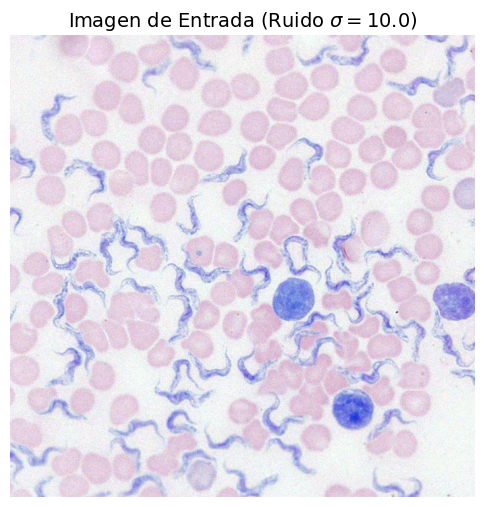

  Ejecutando FCM: C=3, M=1.5...
Iniciando FCM (C=3, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2...
Iniciando FCM (C=3, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2.5...
Iniciando FCM (C=3, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=1.5...
Iniciando FCM (C=4, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2...
Iniciando FCM (C=4, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2.5...
Iniciando FCM (C=4, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=1.5...
Iniciando FCM (C=5, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2...
Iniciando FCM (C=5, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2.5...
Iniciando FCM (C=5, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).


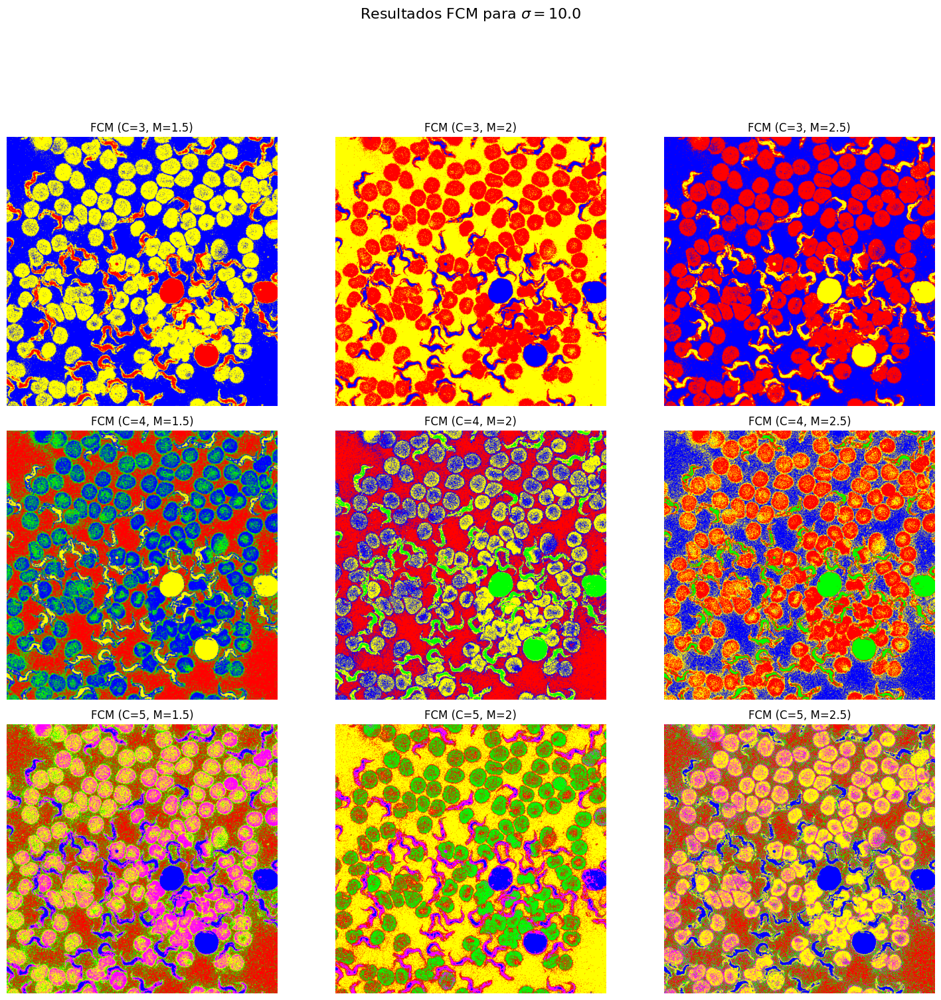


--- PRUEBA FCM CON RUIDO SIGMA = 15.0 ---


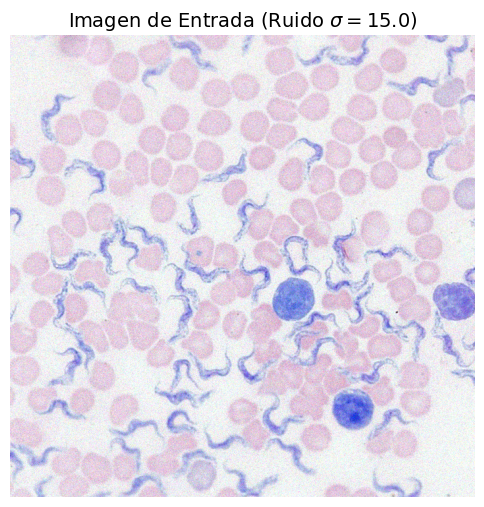

  Ejecutando FCM: C=3, M=1.5...
Iniciando FCM (C=3, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2...
Iniciando FCM (C=3, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2.5...
Iniciando FCM (C=3, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=1.5...
Iniciando FCM (C=4, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2...
Iniciando FCM (C=4, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2.5...
Iniciando FCM (C=4, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=1.5...
Iniciando FCM (C=5, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2...
Iniciando FCM (C=5, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2.5...
Iniciando FCM (C=5, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).


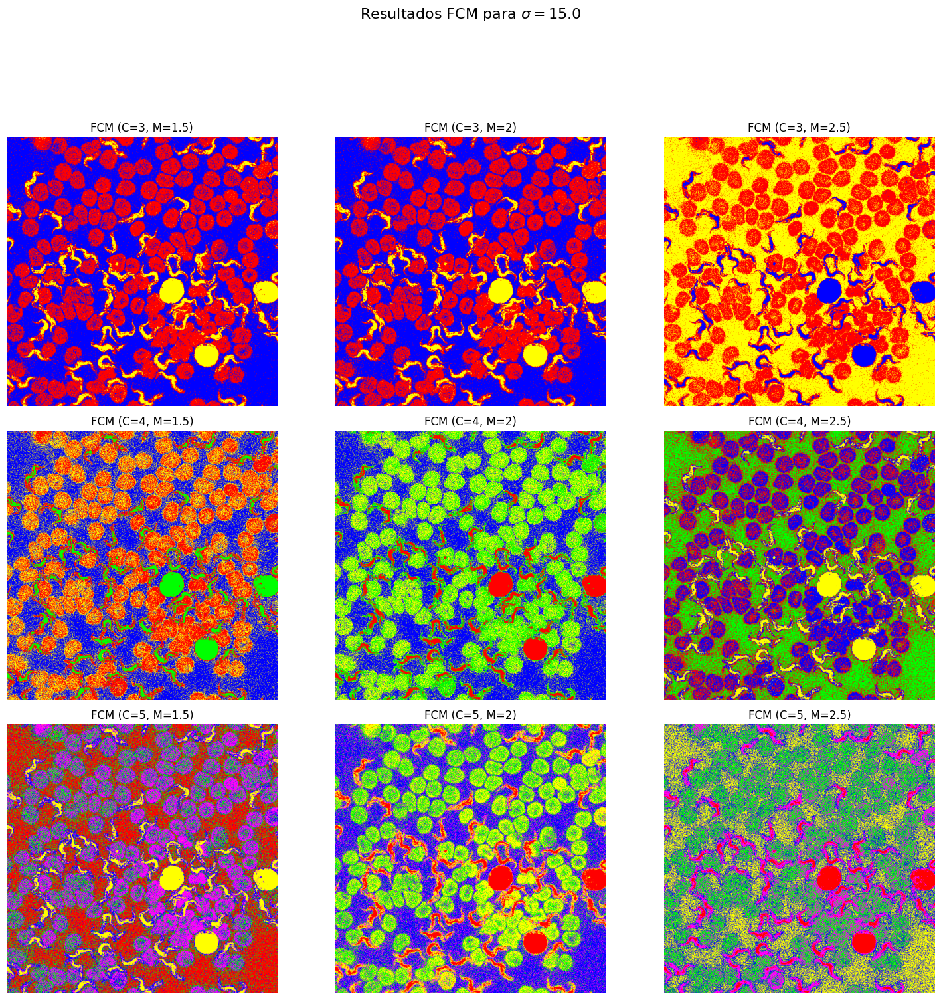


--- PRUEBA FCM CON RUIDO SIGMA = 30.0 ---


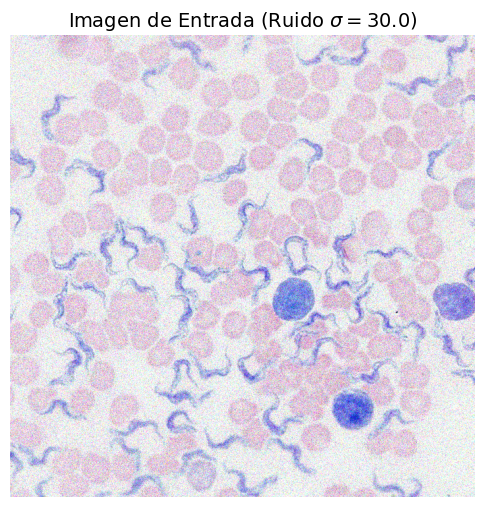

  Ejecutando FCM: C=3, M=1.5...
Iniciando FCM (C=3, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2...
Iniciando FCM (C=3, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=3, M=2.5...
Iniciando FCM (C=3, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=1.5...
Iniciando FCM (C=4, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2...
Iniciando FCM (C=4, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=4, M=2.5...
Iniciando FCM (C=4, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=1.5...
Iniciando FCM (C=5, M=1.5)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2...
Iniciando FCM (C=5, M=2)...
FCM alcanzó el máximo de iteraciones (10).
  Ejecutando FCM: C=5, M=2.5...
Iniciando FCM (C=5, M=2.5)...
FCM alcanzó el máximo de iteraciones (10).


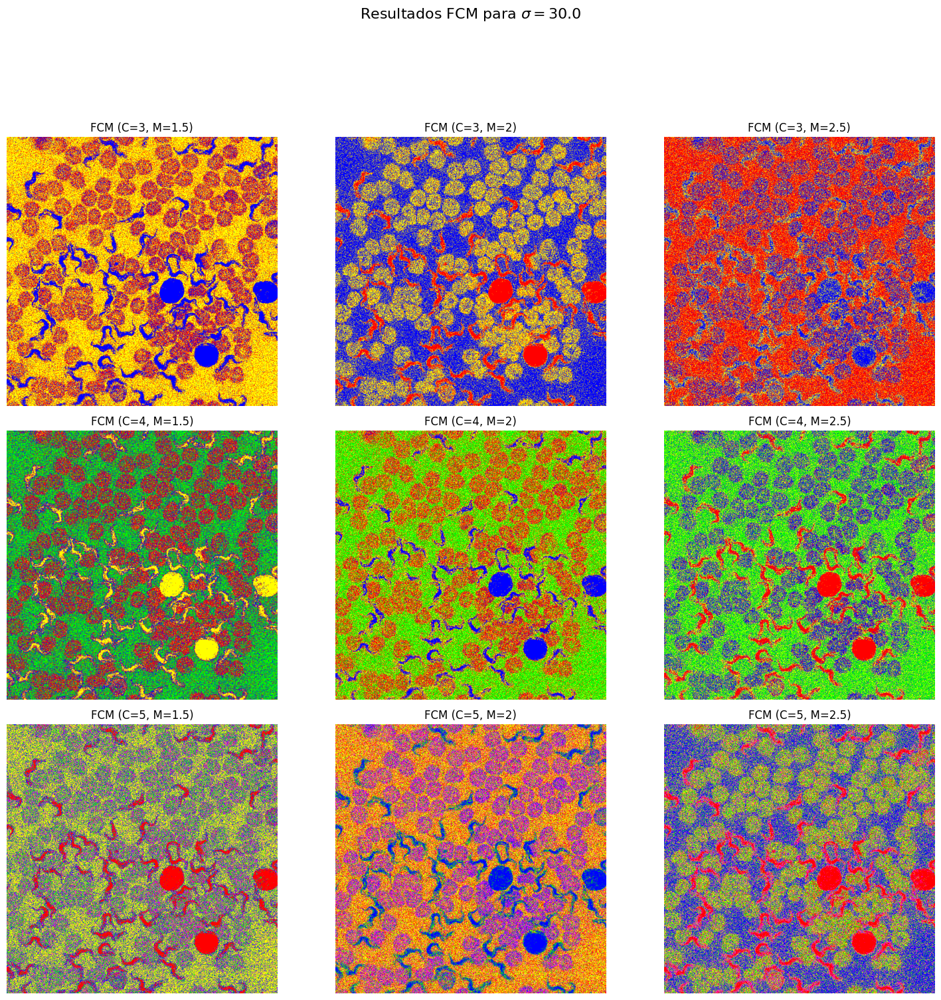

In [6]:
# --- PRUEBAS de FCM ---
valores_C = [3, 4, 5]          # Filas de la parrilla
valores_M = [1.5, 2, 2.5]      # Columnas de la parrilla
valores_SIGMA = [10.0, 15.0, 30.0]  # Diferentes niveles de ruido a probar

# --- Bucle de Pruebas ---
for sigma in valores_SIGMA:
    print(f"\n" + "="*40)
    print(f"--- PRUEBA FCM CON RUIDO SIGMA = {sigma} ---")
    print("="*40)
    
    # 1. Generar la imagen ruidosa para esta prueba
    img_ruido_test = aplica_ruido_gausiano(img_norm, Ruido_MEAN, sigma)
    data_ruido_test, shape_original_test = preparacion_datos(img_ruido_test)
    
    # 2. Mostrar la imagen de entrada por separado
    plt.figure(figsize=(6, 6))
    plt.title(f"Imagen de Entrada (Ruido $\\sigma={sigma}$)", fontsize=14)
    plt.imshow(img_ruido_test)
    plt.axis('off')
    plt.show()

    # 3. Crear la parrilla para los resultados
    num_c = len(valores_C)
    num_m = len(valores_M)
    # Ajustamos el tamaño: 5 pulgadas por cada columna/fila
    fig, axes = plt.subplots(num_c, num_m, figsize=(num_m * 5, num_c * 5))
    fig.suptitle(f'Resultados FCM para $\\sigma={sigma}$', fontsize=16, y=1.03)

    # 4. Iterar, calcular y rellenar la parrilla
    for i, c in enumerate(valores_C):
        for j, m in enumerate(valores_M):
            print(f"  Ejecutando FCM: C={c}, M={m}...")
            
            # Ejecutar FCM
            centroides, U = fuzzy_c_means(data_ruido_test, c, m, MAX_ITER, EPSILON)
            
            # Generar imagen segmentada
            img_segmentada = defuzzify_image(data_ruido_test, centroides, U, shape_original_test)
            
            # Seleccionar el subplot correcto
            ax = axes[i, j]
            
            # Mostrar la imagen segmentada
            ax.imshow(np.clip(img_segmentada, 0, 1))
            ax.set_title(f"FCM (C={c}, M={m})")
            ax.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

### Efecto del Ruido en las pruebas

El efecto del ruido en la pruebas es **determinante**, en todos los casos impide ver de manera correcta la imagen y vemos que FCM no es capaz de corregirlo.

Por tanto el efecto del ruido en la segmentación cumple con el **comportamiento esperado** ya que vemos que al aumentarlo tambien empeora la segmentación independientemente de los otros parámetros.


#### Efecto de `C` (Número de Clusters) - (Filas)

* **Fila 1 (C=3):** El algoritmo intenta forzar todos los píxeles de la imagen en solo 3 grupos de color. Esto provoca que regiones que son visiblemente distintas (ej. el rojo y el amarillo) puedan ser fusionadas en un solo cluster.

* **Fila 2 (C=4):** Este valor (4 clusters) parece el más apropiado para la imagen original (que tiene 4 componentes principales: azul, verde, rojo, amarillo).

* **Fila 3 (C=5):** El algoritmo "inventa" un quinto cluster. Esto puede causar que una región coherente (ej. el azul) se divida en dos sub-clusters (ej. "azul claro" y "azul oscuro").

**Conclusión (Efecto `C`):** El parámetro `C` funciona como se espera (define el número de colores finales), pero es incapaz de solucionar el problema del ruido.

#### Efecto de `M` (Exponente de Fusión) - (Columnas)

* **Columna 1 (M=1.5):** Un `M` bajo se acerca a un clustering "duro" (K-Means). Esto hace que el algoritmo sea **más sensible a los valores atípicos (ruido)**. El resultado es el más fragmentado y ruidoso de la parrilla.

* **Columna 2 (M=2.0):** El valor estándar. Es el punto de equilibrio.

* **Columna 3 (M=2.5):** Un `M` alto incrementa la "borrosidad" (fuzziness). Esto hace que el algoritmo sea ligeramente **más robusto al ruido**, ya que las pertenencias están más repartidas. Si te fijas bien, la segmentación en esta columna es *muy sutilmente* más suave y menos "granulada" que en la columna de `M=1.5`.

**Conclusión (Efecto `M`):** El parámetro `M` tiene el efecto teórico esperado (más `M` = más suave), pero la diferencia es casi despreciable. El ruido es demasiado para él.

### Conclusión: ¿Cumplen con lo Esperado?

**Sí, los resultados cumplen perfectamente con lo esperado.**

La expectativa de esta prueba era demostrar visualmente la **debilidad fundamental de FCM** para la segmentación de imágenes ruidosas.

Estas imágenes prueban que no importa cómo ajustes los parámetros `C` y `M`: si el algoritmo no tiene un componente **espacial** (es decir, si no mira a los píxeles vecinos), el ruido de la imagen de entrada destruirá la segmentación.

#### Ejecución de FCM con parámteros estandar

Para poder realizar una **comparación justa** entre el algoritmo FCM (Fuzzy C-Means) y el sFCM (Spatial Fuzzy C-Means), es fundamental que ambos se enfrenten al mismo problema bajo las mismas condiciones.

Por esta razón, definimos un conjunto de parámetros estándar para la prueba al inicio de la práctica y en la siguiente celda vamos a ejecutar FCM para estos valores:

* **`C = 4`** (Número de Clusters)
* **`m = 2.0`** (Exponente de Fusión)
* **`sigma = 15.0`** (Nivel de Ruido de Entrada)

### Número de Clusters: `C = 4`

* **¿Por qué este valor?**: Esta elección no es aleatoria, sino que **está definida por la propia imagen de entrada** (`ImagenMicroscopiaColor.png`) ya que visualemnte somos capaces de distinguir cuatro grupos de color.

* **Importancia para la Comparación**: Al fijar `C=4`, forzamos a ambos algoritmos a resolver el problema "correcto". Usar un valor diferente (como C=3 o C=5) haría que la segmentación fallase, no por culpa del algoritmo, sino porque le estaríamos pidiendo encontrar un número incorrecto de regiones.


### Exponente de Fusión: `m = 2.0`

* **¿Por qué este valor?**: El valor `m=2.0` es un **estándar** sobre Fuzzy C-Means. Es el valor más comúnmente usado y recomendado, ya que ofrece el mejor equilibrio:

    * No es "duro" (como `m` cercano a 1, que lo haría idéntico a K-Means y muy sensible al ruido).

    * No es "excesivamente borroso" (como `m` muy altos, que harían que todos los clusters se mezclasen).

* **Importancia para la Comparación**: Usar el valor estándar (`m=2.0`) para ambos algoritmos asegura que ninguno de ellos esté operando en una configuración extraña o subóptima. Es la base de referencia neutral.


### Nivel de Ruido: `sigma = 15.0`

* **¿Por qué este valor?**

    * `sigma=15.0` representa un **nivel de ruido moderado**: es lo suficientemente alto como para destruir por completo el resultado del algoritmo FCM estándar, pero lo suficientemente bajo como para que la estructura de la imagen siga siendo visible para el algoritmo sFCM (y para el ojo humano).

* **Importancia para la Comparación**: Esta es la **variable de control** clave. Al dar *exactamente la misma imagen ruidosa* (`sigma=15.0`) a ambos algoritmos, podemos atribuir la diferencia en el resultado *directamente* a la arquitectura del algoritmo (es decir, al hecho de que sFCM usa información espacial y FCM no).



Iniciando FCM (C=4, M=2.0)...
FCM alcanzó el máximo de iteraciones (10).


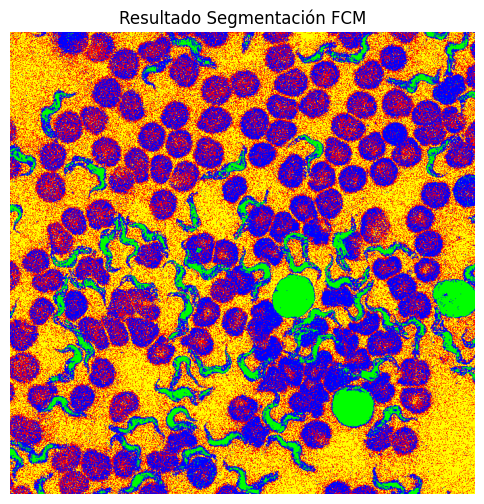

In [12]:
# --- Ejecutar FCM con opciones fijas---
fcm_centroides, fcm_U = fuzzy_c_means(data_ruido, C, M, MAX_ITER, EPSILON)

# --- Generar Imagen Segmentada ---
fcm_imagen_segmentada = defuzzify_image(data_ruido, fcm_centroides, fcm_U, shape_original)

# Mostrar el resultado de FCM
plt.figure(figsize=(6, 6))
plt.title("Resultado Segmentación FCM")
# Hacemos clip por si los centroides cayeron ligeramente fuera de [0, 1]
plt.imshow(np.clip(fcm_imagen_segmentada, 0, 1))
plt.axis('off')
plt.show()

### 6. Implementación de Spatial FCM (sFCM)
**Spatial Fuzzy C-Means** es a grandes rasgos una versión mejorada de FCM diseñada para ser robusta frente al ruido.

**Fundamento**

La idea clave es que un píxel debería tener una alta probabilidad de pertenecer al mismo cluster que sus **vecinos espaciales**. El algoritmo incorpora esta información espacial en el cálculo de la pertenencia.

**Diferencia clave con FCM:**

La actualización de la matriz de pertenencia $U_{ik}$ se modifica. Además de la distancia al centroide (componente de color), se añade un término que representa la influencia de los vecinos.

1.  **Cálculo del Término Espacial ($h_{ik}$)**:

    Primero, se calcula un término de influencia espacial $h_{ik}$. Este término es, en esencia, la suma de las pertenencias de los píxeles vecinos (en una ventana, ej. 3x3) al cluster $i$.
    $$h_{ik} = \sum_{j \in \mathcal{N}(k)} U_{ij}$$
    (Donde $\mathcal{N}(k)$ es el vecindario del píxel $k$). Si los vecinos de $k$ tienen una alta pertenencia al cluster $i$, $h_{ik}$ será grande.

2.  **Nueva Actualización de $U_{ik}$**:

    La fórmula de actualización de $U$ se modifica para incluir $h_{ik}$. Una formulación común (como la que implementa el código) es:
    $$U_{ik} \propto (d(X_k, V_i))^{\frac{-2}{m-1}} \cdot (h_{ik})^\alpha$$
    
    * El primer término $(distancia)$ tira del píxel hacia el cluster cuyo color está más cerca.

    * El segundo término $(espacial)$ tira del píxel hacia el cluster al que pertenecen sus vecinos.

    * El parámetro **`alfa` ($\alpha$)** equilibra la importancia entre la información de color (FCM estándar) y la información espacial (vecinos). Un $\alpha$ alto da más peso a los vecinos.

In [6]:
def calculo_funcion_espacial(U, H, W, N_clusters):
    """
    Calcula la función espacial h (suma de pertenencias en la vecindad)
    para cada píxel 'k' y cada clúster 'i', SIN usar convolve2d.
    
    Args:
        U (np.array): Matriz de pertenencia (N, C), donde N = H * W
        H (int): Número de filas de la imagen original.
        W (int): Número de columnas de la imagen original.
        N_clusters (int): Número de clústeres (C).
        
    Returns:
        np.array: Matriz H (N, C) con la suma espacial.
    """
    
    # Reformateamos U a su forma 2D (imagen) para acceder por (fila, col)
    # El shape es (H, W, C)
    try:
        U_2d = U.reshape((H, W, N_clusters))
    except ValueError:
        # Si N_clusters no coincide por algún motivo, usamos el de U
        N_clusters = U.shape[1]
        U_2d = U.reshape((H, W, N_clusters))

    # Matriz H de salida, también en formato 2D
    H_2d = np.zeros_like(U_2d, dtype=np.float32)
    
    # 1. Iteración por CADA píxel (fila, columna)
    for r in range(H):
        for c in range(W):
            
            # 2. Para este píxel (r, c), iteramos por cada clúster 'i'
            for i_cluster in range(N_clusters):
                
                suma_vecindad = 0.0
                
                # 3. Iteramos por su vecindad de 3x3
                for i_vecino in range(-1, 2): 
                    for j_vecino in range(-1, 2):
                        
                        # Calculo de las coordenadas del vecino
                        vecino_r = r + i_vecino
                        vecino_c = c + j_vecino
                        
                        # 4. Comprobación de que el vecino está DENTRO de la imagen
                        if (0 <= vecino_r < H) and (0 <= vecino_c < W):
                            # Si está dentro, sumamos su pertenencia al clúster 'i'
                            suma_vecindad += U_2d[vecino_r, vecino_c, i_cluster]
                        # else:
                            # Si está fuera, no suma nada
                            pass
                
                # Asignación de la suma total de la vecindad al píxel (r, c)
                H_2d[r, c, i_cluster] = suma_vecindad
    
    # --- Fin del reemplazo ---

    # Devolvemos H a su formato "plano" (N, C)
    N_pixels = H * W
    h = H_2d.reshape((N_pixels, N_clusters))
    
    return h.astype(np.float32)


def spatial_fuzzy_c_means(data, C, M, P, Q, H, W, max_iter, epsilon):
    """
    Ejecuta el algoritmo sFCM completo (FCM + Info Espacial).
    """
    print(f"Iniciando sFCM (C={C}, M={M}, P={P}, Q={Q})...")
    
    N_pixels = data.shape[0]
    
    # 1. Inicializar centroides
    centroides = inicializa_centroides(data, C)
    
    # 2. Bucle iterativo
    U_spatial = np.zeros((N_pixels, C), dtype=np.float32)
    
    for i in range(max_iter):
        U_spatial_antiguo = U_spatial.copy()
        
        # --- PASO 1 (FCM Estándar) ---
        # Calcular la membresía U_fcm basada solo en la intensidad/color
        U_fcm, _ = calcula_pertenencia_fcm(data, centroides, M)
        
        # --- PASO 2 (Información Espacial) ---
        # a. Calcular la función espacial h
        # Usamos U_fcm como entrada para h
        h = calculo_funcion_espacial(U_fcm, H, W, C)
        
        # b. Calcular la nueva membresía U_spatial
        # Numerador: (U_fcm)^p * h^q
        numerador_spatial = np.power(U_fcm, P) * np.power(h, Q)
        
        # Denominador: sum_k( (U_fcm_k)^p * h_k^q )
        # (N, C) -> (N, 1)
        denominador_spatial = np.sum(numerador_spatial, axis=1, keepdims=True)
        
        # Evitar división por cero
        denominador_spatial = np.fmax(denominador_spatial, 1e-9)
        
        U_spatial = numerador_spatial / denominador_spatial
        
        # 3. Actualizar Centroides
        centroides = actualiza_centroides_fcm(data, U_spatial, M)
        
        # 4. Comprobar criterio de parada
        diff = np.max(np.abs(U_spatial - U_spatial_antiguo))
        if diff < epsilon:
            print(f"sFCM convergió en la iteración {i+1}.")
            break
    else:
        print(f"sFCM alcanzó el máximo de iteraciones ({max_iter}).")
            
    return centroides, U_spatial

### 7. Ejecución y Pruebas de Spatial FCM (sFCM)

Primero ejecutamos como en el caso de FCM las diferentes pruebas sobre el algoritmo para comprobar su funcinamiento cuendo se modifican sus parámetros.

**Metodología:**
La función objetivo de esta versión de sFCM contiene dos términos sumados:

1.  **Término de Datos (Color)**: Mide la similitud (distancia) entre el color de un píxel y el centroide de un clúster. Parámetro **p**

2.  **Término Espacial (Vecinos)**: Mide la influencia de los píxeles vecinos en la pertenencia de un píxel a un clúster. Parámetro **q**

Los parámetros `p` y `q` son los exponentes que controlan la influencia relativa de cada uno de estos términos.

**Explicación de los Parámetros a Comparar:**

* **`valores_SIGMA_sFCM = [15.0]` (Fijo)**:
    * Mantenemos el nivel de ruido **constante y moderado**.

* **`valores_C_sFCM = [3, 4, 5]`**:

    * Al igual que en las pruebas de FCM, comprobamos cómo se comporta el algoritmo si le pedimos que encuentre 3, 4 o 5 grupos. Esperamos que `C=4` siga siendo el valor óptimo, ya que la imagen no ha cambiado.

* **`valores_P_sFCM = [0.5, 2.0, 1]` (Filas de la Parrilla)**:

    * **`p` alto (ej. 2.0)**: Da **mucha importancia al color** del píxel. Esto hará que el algoritmo sea más fiel a los datos originales, pero también **mucho más sensible al ruido**.

    * **`p` bajo (ej. 0.5)**: Da **poca importancia al color**. El algoritmo "confiará" menos en el valor del píxel individual.

* **`valores_Q_sFCM = [0.5, 2.0, 1]` (Columnas de la Parrilla)**:

    * **`q` alto (ej. 2.0)**: Da **mucha importancia a los vecinos**. Esto filtrará el ruido de forma muy agresiva, pero corre el riesgo de "sobresuavizar" (oversmoothing) la imagen, borrando detalles finos y fronteras.

    * **`q` bajo (ej. 0.5)**: Da **poca importancia a los vecinos**. El algoritmo será más "conservador" y no filtrará el ruido con tanta eficacia.



--- INICIANDO PRUEBAS sFCM ---
Parámetro Fijo: M = 2.0

Generando imagen con Ruido $\sigma=15.0$...


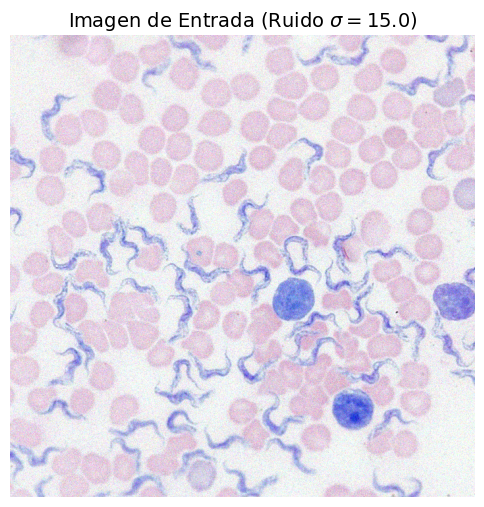


------------------------------
--- Pruebas sFCM para $\sigma=15.0$, C=3 ---
--- (Parrilla 2x2 P vs Q) ---
------------------------------
  Ejecutando sFCM: C=3, P=0.5, Q=0.5...
Iniciando sFCM (C=3, M=2.0, P=0.5, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=0.5, Q=2.0...
Iniciando sFCM (C=3, M=2.0, P=0.5, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=0.5, Q=1...
Iniciando sFCM (C=3, M=2.0, P=0.5, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=2.0, Q=0.5...
Iniciando sFCM (C=3, M=2.0, P=2.0, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=2.0, Q=2.0...
Iniciando sFCM (C=3, M=2.0, P=2.0, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=2.0, Q=1...
Iniciando sFCM (C=3, M=2.0, P=2.0, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=3, P=1, Q=0.5...
Iniciando sFCM (C=3, M=2.0, P=1, Q=0.5)...
sFCM alcanzó el

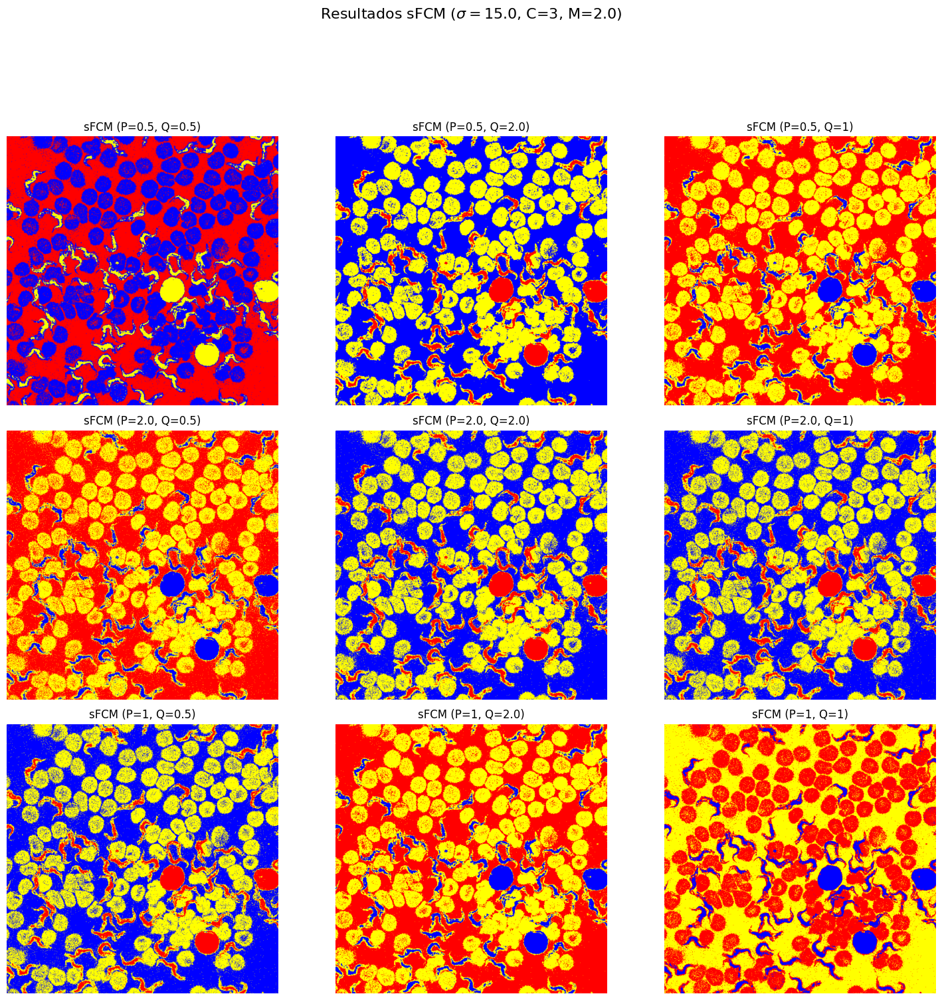


------------------------------
--- Pruebas sFCM para $\sigma=15.0$, C=4 ---
--- (Parrilla 2x2 P vs Q) ---
------------------------------
  Ejecutando sFCM: C=4, P=0.5, Q=0.5...
Iniciando sFCM (C=4, M=2.0, P=0.5, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=0.5, Q=2.0...
Iniciando sFCM (C=4, M=2.0, P=0.5, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=0.5, Q=1...
Iniciando sFCM (C=4, M=2.0, P=0.5, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=2.0, Q=0.5...
Iniciando sFCM (C=4, M=2.0, P=2.0, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=2.0, Q=2.0...
Iniciando sFCM (C=4, M=2.0, P=2.0, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=2.0, Q=1...
Iniciando sFCM (C=4, M=2.0, P=2.0, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=4, P=1, Q=0.5...
Iniciando sFCM (C=4, M=2.0, P=1, Q=0.5)...
sFCM alcanzó el

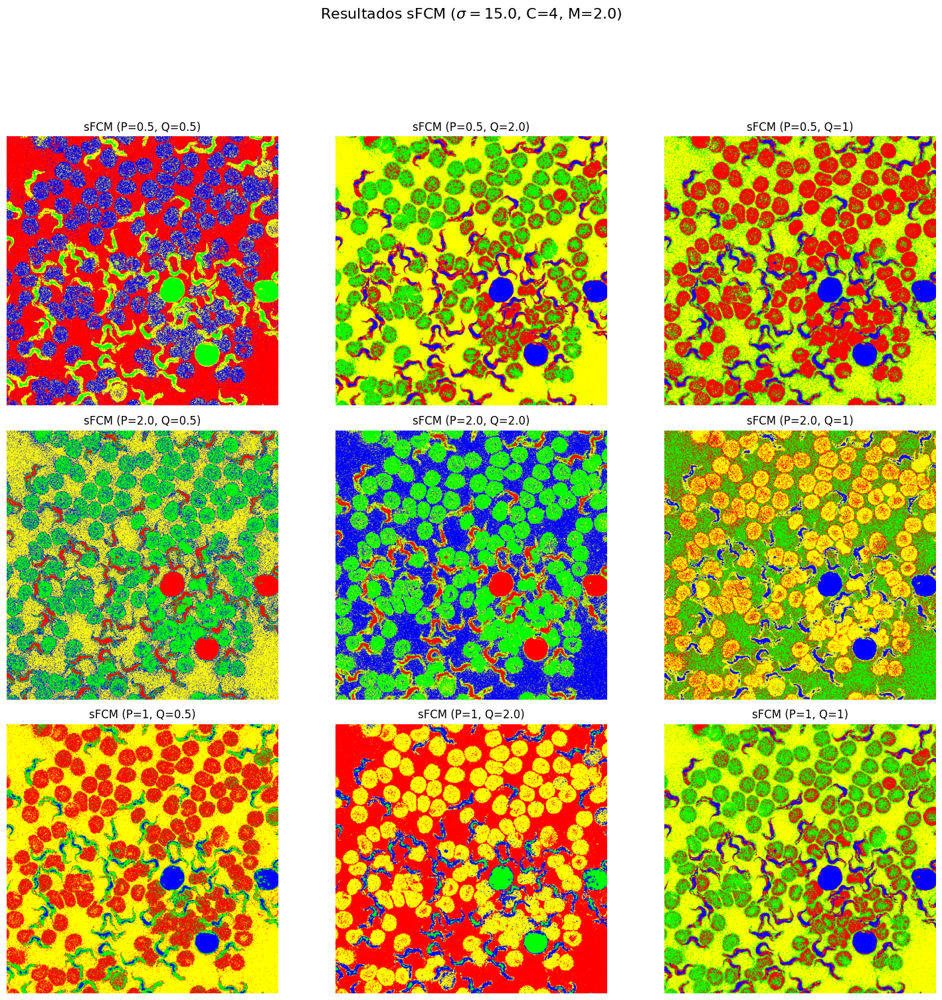


------------------------------
--- Pruebas sFCM para $\sigma=15.0$, C=5 ---
--- (Parrilla 2x2 P vs Q) ---
------------------------------
  Ejecutando sFCM: C=5, P=0.5, Q=0.5...
Iniciando sFCM (C=5, M=2.0, P=0.5, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=0.5, Q=2.0...
Iniciando sFCM (C=5, M=2.0, P=0.5, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=0.5, Q=1...
Iniciando sFCM (C=5, M=2.0, P=0.5, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=2.0, Q=0.5...
Iniciando sFCM (C=5, M=2.0, P=2.0, Q=0.5)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=2.0, Q=2.0...
Iniciando sFCM (C=5, M=2.0, P=2.0, Q=2.0)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=2.0, Q=1...
Iniciando sFCM (C=5, M=2.0, P=2.0, Q=1)...
sFCM alcanzó el máximo de iteraciones (10).
  Ejecutando sFCM: C=5, P=1, Q=0.5...
Iniciando sFCM (C=5, M=2.0, P=1, Q=0.5)...
sFCM alcanzó el

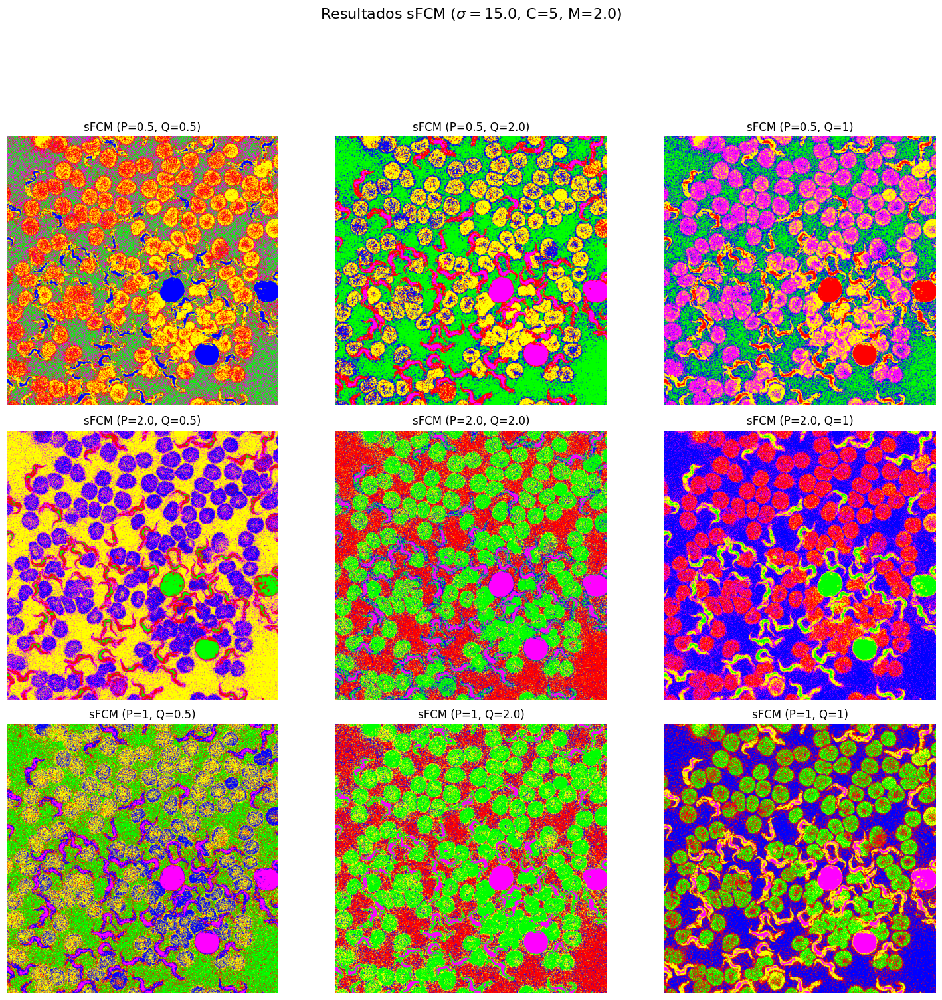


--- PRUEBAS sFCM FINALIZADAS ---


In [14]:
# --- PRUEBAS de sFCM ---

# 1. Variables a iterar (Bucles externos)
valores_SIGMA_sFCM = [15.0]  # Probamos con el mismo ruido 
valores_C_sFCM = [3, 4, 5]            # Probamos con 4 y 5 grupos

# 2. Variables de la parrilla
valores_P_sFCM = [0.5, 2.0, 1]        # Filas de la parrilla
valores_Q_sFCM = [0.5, 2.0, 1]        # Columnas de la parrilla

# 3. Parámetros fijos
if 'M' not in locals():
    M = 2.0  
    print("Variable 'M' no encontrada, usando M=2.0 por defecto.")

# --- Bucle de Pruebas ---

print(f"--- INICIANDO PRUEBAS sFCM ---")
print(f"Parámetro Fijo: M = {M}")

# Bucle externo para el RUIDO
for sigma in valores_SIGMA_sFCM:
    
    # 1. Generar la imagen ruidosa una vez por cada nivel de ruido
    print(f"\n" + "="*40)
    print(f"Generando imagen con Ruido $\\sigma={sigma}$...")
    img_ruido_test = aplica_ruido_gausiano(img_norm, Ruido_MEAN, sigma)
    data_ruido_test, shape_test = preparacion_datos(img_ruido_test)
    H, W = shape_test

    # 2. Mostrar la imagen de entrada para esta ronda de pruebas
    plt.figure(figsize=(6, 6))
    plt.title(f"Imagen de Entrada (Ruido $\\sigma={sigma}$)", fontsize=14)
    plt.imshow(img_ruido_test)
    plt.axis('off')
    plt.show()

    # Bucle externo para los CENTROIDES
    for c in valores_C_sFCM:
        
        print(f"\n" + "-"*30)
        print(f"--- Pruebas sFCM para $\\sigma={sigma}$, C={c} ---")
        print(f"--- (Parrilla 2x2 P vs Q) ---")
        print(f"-"*30)

        # 3. Crear la parrilla 2x2 para P y Q
        num_p = len(valores_P_sFCM)
        num_q = len(valores_Q_sFCM)
        fig, axes = plt.subplots(num_p, num_q, figsize=(num_q * 5, num_p * 5))
        
        # Título descriptivo para la parrilla
        fig.suptitle(f'Resultados sFCM ($\\sigma={sigma}$, C={c}, M={M})', fontsize=16, y=1.03)

        # 4. Iterar, calcular y rellenar la parrilla 2x2
        for i, p in enumerate(valores_P_sFCM):
            for j, q in enumerate(valores_Q_sFCM):
                
                print(f"  Ejecutando sFCM: C={c}, P={p}, Q={q}...")
                
                # Ejecutar sFCM
                # Usamos data_ruido_test, c, M, p, q, H, W
                centroides, U = spatial_fuzzy_c_means(data_ruido_test, c, M, p, q, H, W, MAX_ITER, EPSILON)
                
                # Generar imagen segmentada
                img_segmentada = defuzzify_image(data_ruido_test, centroides, U, shape_test)
                
                # Seleccionar el subplot correcto
                ax = axes[i, j]

                # Mostrar la imagen segmentada
                ax.imshow(np.clip(img_segmentada, 0, 1))
                ax.set_title(f"sFCM (P={p}, Q={q})")
                ax.axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Ajustar para el super-título
        plt.show()

print("\n" + "="*40)
print("--- PRUEBAS sFCM FINALIZADAS ---")
print("="*40)

### Prueba de sFCM con diferentes niveles de ruido

Se va a someter al algoritmo a tres niveles crecientes de ruido (`sigma`) y observar cómo se degrada su rendimiento.

### Metodología

El código **fija** los parámetros óptimos (`C=4, M=2.0, P=1.0, Q=1.0`).

Luego, ejecuta un bucle **tres veces**, una para cada nivel de ruido:

1.  `sigma = 10.0` (Ruido Bajo)

2.  `sigma = 15.0` (Ruido Moderado)

3.  `sigma = 30.0` (Ruido Alto/Extremo)

En cada una de las tres iteraciones, el código:

1.  Generará la imagen de entrada con el nivel de ruido `sigma` correspondiente.

2.  Mostrará esta **Imagen de Entrada (Ruidosa)**.

3.  Ejecutará `spatial_fuzzy_c_means` **una sola vez** sobre esa imagen.

4.  Mostrará el **Resultado sFCM** final.

--- INICIANDO PRUEBAS sFCM (Efecto del Ruido) ---
Parámetros Fijos: C=4, M=2.0, P=1.0, Q=1.0

--- PRUEBA CON RUIDO $\sigma=10.0$ ---
Generando imagen con Ruido $\sigma=10.0$...


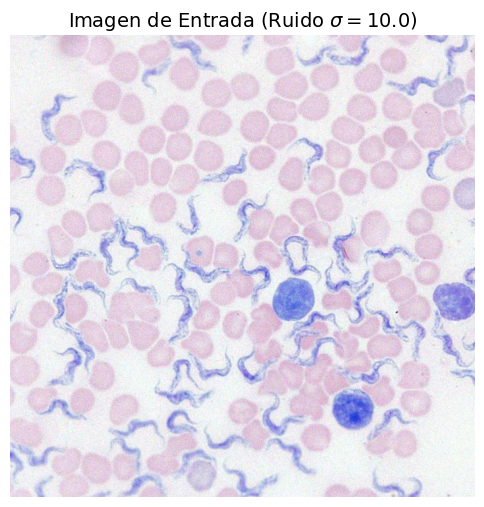

  Ejecutando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
Iniciando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
sFCM alcanzó el máximo de iteraciones (10).


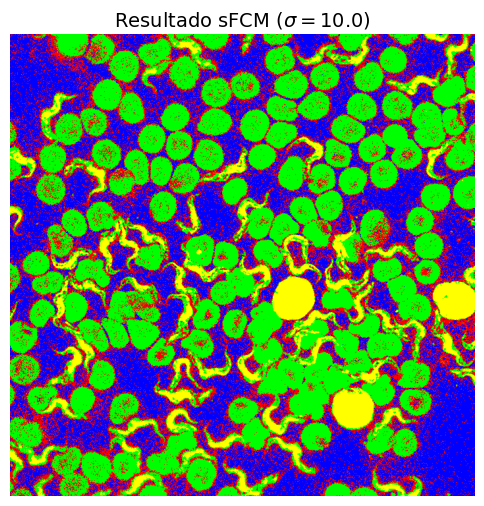


--- PRUEBA CON RUIDO $\sigma=15.0$ ---
Generando imagen con Ruido $\sigma=15.0$...


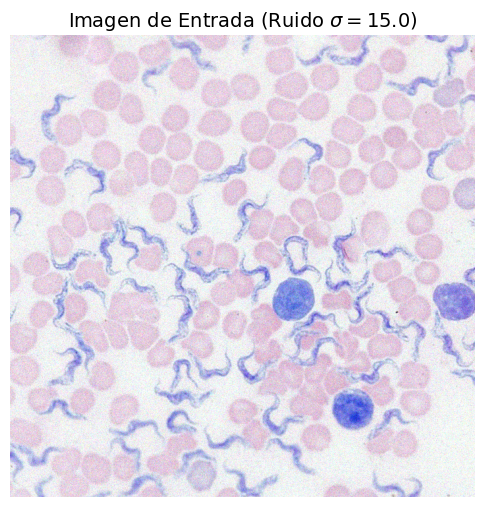

  Ejecutando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
Iniciando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
sFCM alcanzó el máximo de iteraciones (10).


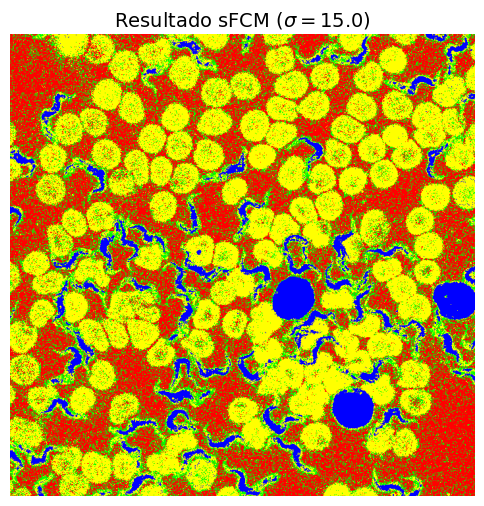


--- PRUEBA CON RUIDO $\sigma=30.0$ ---
Generando imagen con Ruido $\sigma=30.0$...


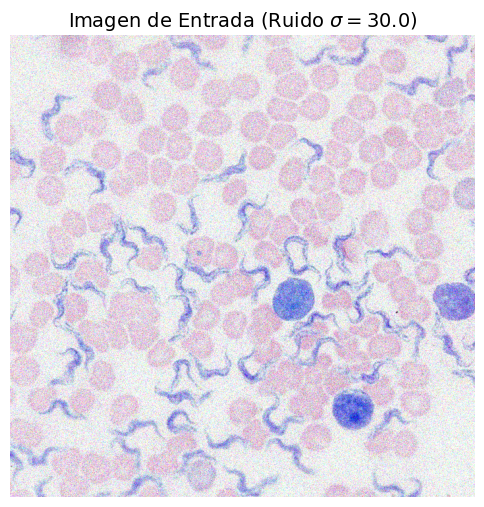

  Ejecutando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
Iniciando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
sFCM alcanzó el máximo de iteraciones (10).


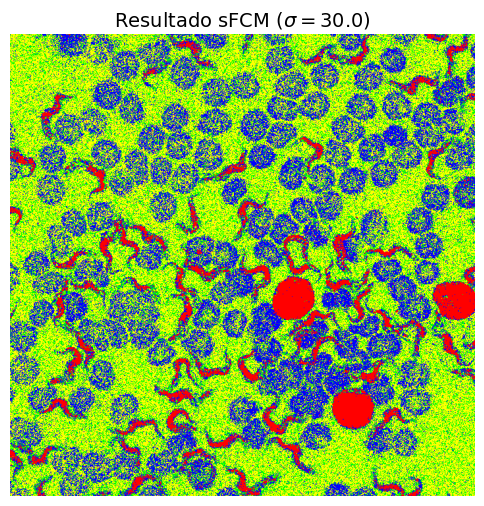


--- PRUEBAS sFCM (Efecto del Ruido) FINALIZADAS ---


In [9]:
# --- PRUEBAS de sFCM (MODIFICADO PARA PROBAR SÓLO EFECTO DE RUIDO) ---

# --- 1. Parámetros Fijos para sFCM ---
C_fijo = 4
M_fijo = 2.0
P_fijo = 1.0
Q_fijo = 1.0

# --- 2. Variable a iterar ---
# Los 3 niveles de ruido que quieres comparar
valores_SIGMA_test = [10.0, 15.0, 30.0]

# --- 3. Parámetros fijos ---
if 'M' not in locals():
    M = M_fijo  # Usamos el valor fijo
    print(f"Variable 'M' no encontrada, usando M={M_fijo} por defecto.")
else:
    M = M_fijo # Nos aseguramos de que M es el valor fijo

print(f"--- INICIANDO PRUEBAS sFCM (Efecto del Ruido) ---")
print(f"Parámetros Fijos: C={C_fijo}, M={M_fijo}, P={P_fijo}, Q={Q_fijo}")

# --- Bucle de Pruebas ---

# Bucle externo para el RUIDO
for sigma in valores_SIGMA_test:
    
    print(f"\n" + "="*40)
    print(f"--- PRUEBA CON RUIDO $\\sigma={sigma}$ ---")
    print("="*40)
    
    # 1. Generar la imagen ruidosa
    print(f"Generando imagen con Ruido $\\sigma={sigma}$...")
    # Asegúrate de que 'img_norm' y 'Ruido_MEAN' existen
    img_ruido_test = aplica_ruido_gausiano(img_norm, Ruido_MEAN, sigma) 
    data_ruido_test, shape_test = preparacion_datos(img_ruido_test)
    H, W = shape_test # Obtenemos Alto y Ancho

    # 2. Mostrar la imagen de entrada para esta prueba
    plt.figure(figsize=(6, 6))
    plt.title(f"Imagen de Entrada (Ruido $\\sigma={sigma}$)", fontsize=14)
    plt.imshow(img_ruido_test)
    plt.axis('off')
    plt.show()

    # 3. Ejecutar sFCM UNA VEZ con los parámetros fijos
    print(f"  Ejecutando sFCM (C={C_fijo}, M={M_fijo}, P={P_fijo}, Q={Q_fijo})...")
    
    # Asegúrate de que 'MAX_ITER' y 'EPSILON' existen
    centroides, U = spatial_fuzzy_c_means(data_ruido_test, C_fijo, M_fijo, P_fijo, Q_fijo, H, W, MAX_ITER, EPSILON)
    
    # 4. Generar imagen segmentada
    img_segmentada = defuzzify_image(data_ruido_test, centroides, U, shape_test)
    
    # 5. Mostrar la imagen de resultado
    plt.figure(figsize=(6, 6))
    plt.imshow(np.clip(img_segmentada, 0, 1))
    plt.title(f"Resultado sFCM ($\\sigma={sigma}$)", fontsize=14)
    plt.axis('off')
    plt.show()


print("\n" + "="*40)
print("--- PRUEBAS sFCM (Efecto del Ruido) FINALIZADAS ---")
print("="*40)

## Resultados ajuste de sigma (ruido)

El algoritmo sFCM está funcionando con un **equilibrio 1:1** (`P=1.0`, `Q=1.0`). Esto significa que, para cada píxel, el algoritmo da la **misma importancia** a dos factores:

1.  **La Fuerza del Color (`P=1.0`)**

2.  **La Fuerza Espacial (`Q=1.0`)**

**El Efecto del Ruido:**
El ruido es un ataque directo a la **Fuerza del Color**. A medida que `sigma` (ruido) aumenta, el color del píxel se vuelve menos fiable. El trabajo del algoritmo es usar la **Fuerza Espacial** para compensar.

### Resultados para cada Nivel de Ruido

#### Prueba con `sigma = 10.0` (Ruido Bajo)

* **Imagen de Entrada**: La imagen está ligeramente granulada. El ruido es visible, pero leve.

* **Resultado Esperado de sFCM**: Un **éxito casi perfecto**. El nivel de ruido es tan bajo que la "Fuerza Espacial" (`Q=1.0`) domina sin esfuerzo a los pocos píxeles ruidosos. La segmentación resultante es bastante **limpia**

#### Prueba con `sigma = 15.0` (Ruido Moderado)

* **Imagen de Entrada**: La imagen está más corrupta. Este es el nivel de ruido que usamos en la comparativa final.

* **Resultado Esperado de sFCM**: Un **buen resultado**. Este es el escenario para el que se diseñaron estos parámetros. El algoritmo demuestra su robustez, filtrando la mayoría del ruido. El resultado es una segmentación coherente.

#### Prueba con `sigma = 30.0` (Ruido Alto/Extremo)

* **Imagen de Entrada**: La imagen está **muy degradada**. El ruido es tan intenso que las propias estructuras de color empiezan a ser difíciles de distinguir, incluso para el ojo humano.

* **Resultado Esperado de sFCM**: Aquí es donde esperamos ver el **límite o el punto de ruptura** del algoritmo.

    * La "Fuerza del Color" (`P=1.0`) es menos util, ya que la mayoría de los píxeles tienen un color incorrecto.

    * La "Fuerza Espacial" (`Q=1.0`) intenta compensarlo, pero el ruido es tan denso que **incluso los vecindarios pueden estar corruptos**.

    * **El resultado es un "éxito parcial"**. El algoritmo filtra la mayor parte del ruido de "sal y pimienta", pero el resultado es notablemente **más borroso**.

**Conclusión** A diferencia de las pruebas de FCM, estas pruebas demuestran que **sFCM SÍ es capaz de gestionar el ruido de una manera mejor**.


## Resultados ajuste de parámetos p y q

### Efecto de `C` (Número de Clusters)

Este parámetro se comporta exactamente como se esperaba, independientemente del filtrado de ruido:

* **Resultados para `C=3`**: La segmentación es limpia (gracias a `p` y `q`), pero **incorrecta**. El algoritmo se ve forzado a agrupar en 3 clústeres una imagen que visiblemente tiene 4, provocando que se fusionen regiones distintas.

* **Resultados para `C=4`**: Esta parrilla muestra los **resultados óptimos**. El algoritmo busca 4 clústeres y, con los `p` y `q` adecuados, es capaz de identificar limpiamente las 4 regiones.

* **Resultados para `C=5`**: La segmentación vuelve a ser **incorrecta**. El algoritmo "inventa" un quinto clúster que no existe en la realidad. Esto se ve claramente en cómo divide la región azul (la más grande) en dos sub-clústeres.

**Conclusión (Efecto `C`):** Se confirma que **`C=4` es el parámetro correcto** para esta imagen.

### Análisis del Equilibrio `P` vs. `Q` (`C=4`)

Ahora, centrémonos en la imagen de resultados (`C=4`), que es la más relevante. Aqui se demuestra el equilibrio entre `p` (fidelidad al color) y `q` (fuerza de los vecinos).

#### Casos de Fallo:

1.  **Esquina (P=2.0, Q=0.5) - [Fila 2, Col 1]**: **Resultado MUY RUIDOSO.**

    * Este es el caso donde le damos **mucha importancia al color (`P=2.0`)** pero **casi ninguna a los vecinos (`Q=0.5`)**. El resultado es prácticamente idéntico al de FCM estándar. El algoritmo es incapaz de filtrar el ruido.

2.  **Esquina (P=0.5, Q=2.0) - [Fila 1, Col 2]**: **Resultado BORROSO**

    * Este es el caso opuesto. Le damos **muy poca importancia al color (`P=0.5`)** y **máxima importancia a los vecinos (`Q=2.0`)**. El algoritmo filtra el ruido de forma tan agresiva que "sobresuaviza" la imagen. Las fronteras nítidas se pierden y las regiones se convierten en "manchas" redondeadas.

#### El Mejor Punto:

3.  **Centro (P=1.0, Q=1.0) - [Fila 3, Col 3]**: **Resultado ÓPTIMO.**

    * **Análisis**: Aquí, `P` y `Q` tienen un equilibrio 1:1. El resultado es **excelente**: el ruido de "sal y pimienta" ha desaparecido por completo, pero las fronteras entre las regiones (como la esquina entre el rojo y el amarillo) se mantienen nítidas y bien definidas.

### Conclusión Final de los Resultados

**Sí, los resultados son correctos**

Las pruebas demuestran visualmente que:

1.  **sFCM funciona** y es capaz de superar el ruido que destruía a FCM.

2.  `C=4` es el número de clústeres correcto para la imagen.

3.  El equilibrio entre `p` (color) y `q` (vecinos) es importante. Un `q` bajo no filtra el ruido, y un `q` alto lo sobresuaviza.

4.  Para este problema (`sigma=15.0`), los parámetros óptimos encontrados en la prueba son **`C=4`**, **`M=2.0`**, **`P=1.0`** y **`Q=1.0`**.

## Ejecución de sFCM con los parámetros de comparación

Tras el análisis de todas las pruebas paramétricas (pruebas de FCM y pruebas de P vs Q de sFCM), ahora podemos definir el conjunto de parámetros **óptimo** para ejecutar el algoritmo sFCM.

El objetivo es usar los parámetros estándar (los mismos que usamos en FCM) pero añadiendo el **"equilibrio 1:1"** de P y Q.

Los parámetros para esta ejecución son:

* **`sigma = 15.0`** (Nivel de Ruido)
* **`C = 4`** (Número de Clusters)
* **`m = 2.0`** (Exponente de Fusión)
* **`p = 1.0`** (Exponente de Datos/Color)
* **`q = 1.0`** (Exponente Espacial/Vecinos)

Iniciando sFCM (C=4, M=2.0, P=1.0, Q=1.0)...
sFCM alcanzó el máximo de iteraciones (10).


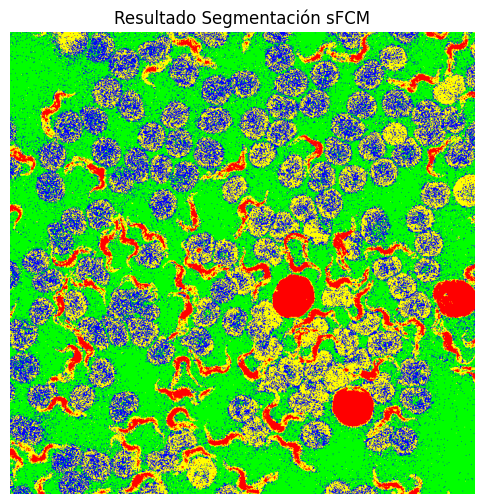

In [ ]:
# --- Ejecutar sFCM ---
sfcm_centroides, sfcm_U = spatial_fuzzy_c_means(data_ruido, C, M, P, Q, H, W, MAX_ITER, EPSILON)

# --- Generar Imagen Segmentada ---
sfcm_imagen_segmentada = defuzzify_image(data_ruido, sfcm_centroides, sfcm_U, shape_original)

# Resultado 

plt.figure(figsize=(6, 6))
plt.title("Resultado Segmentación sFCM")
# Hacemos clip por si los centroides cayeron ligeramente fuera de [0, 1]
plt.imshow(np.clip(sfcm_imagen_segmentada, 0, 1))
plt.axis('off')
plt.show()


### 8. Comprobación y Comparación Final

#### Verificación de la Matrices de Pertenencia

Una de las propiedades matemáticas fundamentales del algoritmo **Fuzzy C-Means (FCM)** es la restricción de que la suma de los grados de pertenencia de *un solo punto* (en nuestro caso, un píxel) a *todos* los clústeres debe ser exactamente **1**.

$$
\sum_{j=1}^{C} u_{ij} = 1, \quad \forall i=1, \dots, N
$$

Donde:
* $N$ es el número total de píxeles.
* $C$ es el número de clústeres.
* $u_{ij}$ es el grado de pertenencia del píxel $i$ al clúster $j$.

**¿Por qué esta comprobación?**

1.  **Validar la implementación:** Esta celda comprueba que la función `actualizar_U_fcm` (y `actualizar_U_sfcm`) es numéricamente correcta. Si las sumas no dieran 1 (o un valor extremadamente cercano, debido a la precisión de los `float`), significaría que hay un error en la implementación de la fórmula de actualización.
2.  **Confirmar la teoría:** Demuestra que el algoritmo está funcionando como se espera. La pertenencia total de un píxel no se "pierde" ni se "crea"; simplemente se *distribuye* de forma difusa (fuzzy) entre los $C$ clústeres. Un píxel en el borde de dos clústeres podría tener `[0.1, 0.45, 0.45, 0.0]`, y un píxel en el centro de uno tendría `[0.97, 0.01, 0.01, 0.01]`. En ambos casos, la suma es 1.

Esta comprobación da la confianza de que los valores de pertenencia son correctos y que por tanto el proceso ha funcionado de manera correcta

In [10]:
# Genero la función que va a verificar que las matrices de pertenencia son correctas

def verificar_matriz_U(nombre_matriz, U):
    """Función para verificar una matriz de pertenencia."""

    # 1. Sumar las pertenencias para cada píxel (a lo largo del eje de clústeres)
    sumas_pertenencia = np.sum(U, axis=1)
        
    # 2. Comprobar si *todas* las sumas son 1.0 (con tolerancia)
    todas_suman_uno = np.allclose(sumas_pertenencia, 1.0)
        
    print(f"\nVerificando '{nombre_matriz}' (forma: {U.shape}):")
        
    if todas_suman_uno:
        print("  ¡VERIFICACIÓN CORRECTA! Todas las sumas de píxeles son ~1.0.")
    else:
        print("  ¡ERROR! No todas las sumas de píxeles son 1.0.")
        
    # 3. Mostrar los valores extremos de la suma
    print(f"      Suma MÍNIMA: {round(np.min(sumas_pertenencia),7)}")
    print(f"      Suma MÁXIMA: {round(np.max(sumas_pertenencia),7)}")

# Verificar U_fcm
verificar_matriz_U('U_fcm', fcm_U)

# Verificar U_sfcm
verificar_matriz_U('U_sfcm', sfcm_U)


Verificando 'U_fcm' (forma: (494906, 4)):
  ¡VERIFICACIÓN CORRECTA! Todas las sumas de píxeles son ~1.0.
      Suma MÍNIMA: 0.9999998211860657
      Suma MÁXIMA: 1.000000238418579

Verificando 'U_sfcm' (forma: (494906, 4)):
  ¡VERIFICACIÓN CORRECTA! Todas las sumas de píxeles son ~1.0.
      Suma MÍNIMA: 0.9999998211860657
      Suma MÁXIMA: 1.000000238418579


Finalmente, comparamos los tres resultados: la imagen ruidosa original, la segmentación con FCM estándar y la segmentación con sFCM.

Esperamos que sFCM produzca regiones más homogéneas y elimine gran parte del ruido (píxeles aislados mal clasificados) que FCM no pudo corregir.

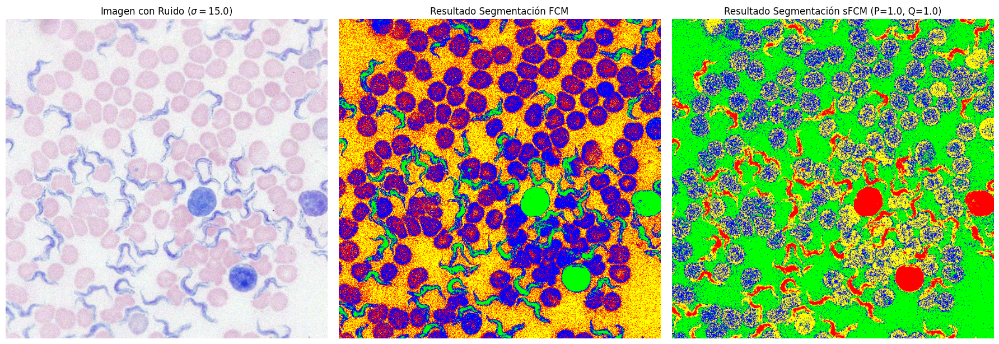

In [13]:
# --- Comparación Final ---
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Imagen Ruidosa
axes[0].imshow(img_ruido)
axes[0].set_title(f"Imagen con Ruido ($\sigma={Ruido_SIGMA}$)")
axes[0].axis('off')

# Resultado FCM
axes[1].imshow(np.clip(fcm_imagen_segmentada, 0, 1))
axes[1].set_title("Resultado Segmentación FCM")
axes[1].axis('off')

# Resultado sFCM
axes[2].imshow(np.clip(sfcm_imagen_segmentada, 0, 1))
axes[2].set_title(f"Resultado Segmentación sFCM (P={P}, Q={Q})")
axes[2].axis('off')

plt.tight_layout()
plt.show()


Tras la implementación de los algoritmos y la visualización de los resultados, podemos extraer conclusiones claras sobre el rendimiento de ambos métodos de clustering.

La comparación visual de las imágenes segmentadas es la prueba más evidente:

1.  **Rendimiento de FCM Estándar:**
    * Al aplicar FCM sobre la imagen con ruido gaussiano, el resultado es **sensible al ruido**.
    * La imagen segmentada presenta una gran cantidad de píxeles clasificados incorrectamente, lo que se conoce como **efecto "sal y pimienta"**.
    * Esto ocurre porque el FCM estándar toma sus decisiones basándose *únicamente* en el valor de color (RGB) de cada píxel, tratándolo de forma aislada. Un píxel ruidoso, aunque esté en medio de una región homogénea, será clasificado incorrectamente si su color se aleja lo suficiente del centroide de esa región.

2.  **Rendimiento de sFCM (Spatial FCM):**
    * Al aplicar sFCM sobre la **misma imagen ruidosa**, el resultado es **superior** y mucho más robusto.
    * El algoritmo logra **eliminar parte del ruido** de la segmentación, produciendo regiones mucho más homogéneas y visualmente coherentes.
    * Esto se debe a la **incorporación de la información espacial** (el término $h_{ij}$). La pertenencia de un píxel ya no depende solo de su color, sino también de las pertenencias de sus vecinos. En la práctica, esto actúa como un "filtro" que corrige las clasificaciones erróneas de píxeles ruidosos aislados, forzándolos a adoptar la clasificación de su vecindario.